### Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
%cd /gdrive

/gdrive


# [Climate Informatics 2020 Data Challenge](https://ci2020.web.ox.ac.uk/)

<div style="text-align: left">
<img src='https://drive.google.com/uc?export=view&id=1lUavschHn-QQwrzRaBLi8W5g0_iLRsqd' width="600px">
</div>

## Generating nighttime satellite imagery from infrared observations

_Redouane Lguensat (LSCE/LOCEAN; IPSL), William Jones (University of Oxford)_

1. [Introduction](#Introduction)
2. [Problem setup](#Problem-setup)
3. [Data](#Data)
4. [Exploratory Data Analysis](#Exploratory-Data-Analysis)
5. [Baseline Solution](#Baseline-Solution)
6. [Submission](#Submitting-to-the-online-challenge)

## Introduction

This year’s data challenge will focus on the prediction of visible imagery at night using thermal infra-red (IR) observations. The overall ambition is to generate predicted visible imagery with sufficient quality such that existing data products that rely on daytime data can be extended to 24 hours.

Earth observation (EO) data is vital for understanding the Earths climate system and predicting the weather. Many of the most frequently used EO instruments detect light in the visible and IR portions of the electromagnetic spectrum. These observations can be used to investigate numerous atmospheric phenomena, both qualitatively through the use of RGB composites, and quantitatively with many retrieval algorithms. Many of these approaches rely on information provided within the visible and near-IR sections of EM spectrum, which is observed due to the reflection of sunlight. This is problematic, as it means for many data products - particularly those used to predict the evolution of storm clouds, or study to properties of clouds and pollution within the atmosphere - no data can be observed at night.

That is not to say that there is no information available at night time. The thermal IR portions of the EM spectrum - which corresponds to heat radiated from the Earths surface and atmosphere - is observed 24/7, and also provides information about many of these phenomena. Although the information contained is too sparse for many of the traditional retrieval algorithms, it is hoped that an ML apporach may be able to produce high quality synthetic visible data using only the thermal IR data available at night

<img src="http://www.barrettbellamyclimate.com/userimages/Sun2.jpg" width="50%">
<div style="text-align: center">Solar and thermal radiation spectrum of the Earths atmosphere. There is very little overlap between the raditiation observed due to reflected sunlight (red) and emitted thermal radiation (blue)</div>

In this challenge, we will be using data provided by the Advanced Baseline Imager (ABI) aboard the Geostionary Operational Environment Satellite (GOES). This is a modern EO platform placed in a geostationary orbit, allowing it to provide visible and IR imagery every ten minutes.

The first part of this challenge will focus on recreating visible imagery composites using images create from a composite of IR channels from ABI. The extension to the challenge is to recreate the solar channels of ABI (channels 1-6) directly from the IR channels (8-16). Note that the solar channels are measured as reflectance, which is scaled from 0-1, and the IR channels are measured as temperature, which is typically in the range of 200-320K (~-70 - +50 degrees Celcius). Use of the raw ABI data may require extra steps to clean the data, including corrections for solar zenith angle (the height of the sun above the horizon)

<img src="https://drive.google.com/uc?export=view&id=1xIu158oKuVurz14ncLFlqgceoSUY3R_u" width="60%">
<div style="text-align: center">The 16 channels of the GOES ABI instrument. Channels 1-6 are detecting reflected solar radiation. Channels 8-16 are emitted thermal radiation. Channel 7 contains both reflected an emitted radiation.</div>

Additional information about the channels used by ABI, and what physical properties they measure, can be found [here](https://www.goes-r.gov/mission/ABI-bands-quick-info.html).


## Problem setup

#### Data sources : 
GOES-16 ABI cloud & moisture imagery product data is provided courtesy of the National Oceanic and Atmospheric Administration (NOAA) Big Data Program. GOES-16 data can be acquired through google cloud storage, https://console.cloud.google.com/marketplace/product/noaa-public/goes-16?filter=solution-type:dataset&q=NOAA&id=5babd633-afa0-4e40-9dba-0587f4aabc47&project=dcc-detect&folder=&organizationId=

Visible RGB and cloud top composite imagery are produced using [satpy](https://satpy.readthedocs.io/en/stable/).

### The regression problem
You will be provided with a dataset comprising couples of RGB images of cloud top images (CloudTop) and their corresponding RGB visible images (TrueColor). Your task is to find a mapping $f$ such as:

**$TrueColor = f(CloudTop)$**

### The metrics
Two metrics are used to assess the performance of your regression in this data challenge. Firstly we consider the well known Root Mean Square Error (RMSE), however it is widely known that the RMSE is not a good metric for images. Thus, we employ the **Structural similarity index (SSIM)** which is more adapted to perceived similarity. The SSIM index of two images $x$ and $y$ is calculated as follows:

$\hbox{SSIM}(x,y) = \frac{(2\mu_x\mu_y + c_1)(2\sigma_{xy} + c_2)}{(\mu_x^2 + \mu_y^2 + c_1)(\sigma_x^2 + \sigma_y^2 + c_2)}$,

please check [here](https://en.wikipedia.org/wiki/Structural_similarity) for details about the different components of this equation. The [skimage implementation](https://scikit-image.org/docs/dev/auto_examples/transform/plot_ssim.html) is used in the scoring program. 

The ranking is done using the SSIM metric, but we provide the RMSE too for information.

## Data

Here we explore predicting visible/solar goes ABI imagery using IR observations. Pairs of images consist of "RGB" composites 

In [ ]:
%matplotlib inline
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img, img_to_array, array_to_img

In [ ]:
CloudTop = np.load("My Drive/DataChallengeCI2020/X_train_CI20.npy")
TrueColor = np.load("My Drive/DataChallengeCI2020/Y_train_CI20.npy")
TrueColor.shape, CloudTop.shape

((8423, 127, 127, 3), (8423, 127, 127, 3))

Show an example

Text(0.5, 1.0, 'Visible RGB')

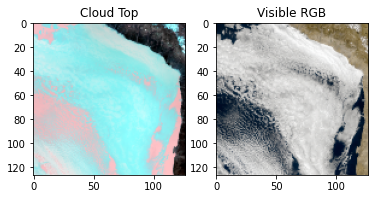

In [ ]:
randindex=np.random.randint(0,TrueColor.shape[0]) #nice image at randindex = 5846
randindex=5847
plt.figure()
plt.subplot(1,2,1)
plt.imshow(array_to_img(CloudTop[randindex,:,:,:]))
plt.title('Cloud Top')

plt.subplot(1,2,2)
plt.imshow(array_to_img(TrueColor[randindex,:,:,:]))
plt.title('Visible RGB')

In [ ]:
a
plt.figure()
plt.subplot(1,2,1)
plt.imshow(array_to_img(CloudTop[randindex,:,:,:]))
plt.title('Cloud Top')

plt.subplot(1,2,2)
plt.imshow(array_to_img(TrueColor[randindex,:,:,:]))
plt.title('Visible RGB')

## Exploratory Data Analysis

### Preprocessing

As you will probably notice, many TrueColor images are all-zeros: they correspond to night images, let us check the percentage of images in this case

In [ ]:
np.mean(TrueColor)

59.351513

In [ ]:
np.sum(np.sum(TrueColor,axis=(1,2,3))<1000000.)/TrueColor.shape[0]

0.5062329336340972

Makes sense, 46% of images need then to be removed

In [59]:
TrueColorNZ = np.delete(TrueColor,np.where(np.sum(TrueColor,axis=(1,2,3))<1000000.),0)
CloudTopNZ = np.delete(CloudTop,np.where(np.sum(TrueColor,axis=(1,2,3))<1000000.),0)

del TrueColor, CloudTop

In [60]:
TrueColorNZ.shape, CloudTopNZ.shape

((4159, 127, 127, 3), (4159, 127, 127, 3))

### Histograms

In [ ]:
pal = ['red', 'green', 'blue']

plt.figure(figsize=(20,6))
plt.subplot(1,2,1)
sns.kdeplot(TrueColorNZ[:,:,:,0].flatten(), color=pal[0])
sns.kdeplot(TrueColorNZ[:,:,:,1].flatten(), color=pal[1])
sns.kdeplot(TrueColorNZ[:,:,:,2].flatten(), color=pal[2])
plt.ylabel('Density')
plt.xlabel('Pixel Value')
plt.title('KDE Plot - Pixel Value by Channel for TrueColor', fontsize=15)

plt.subplot(1,2,2)
sns.kdeplot(CloudTopNZ[:,:,:,0].flatten(), color=pal[0])
sns.kdeplot(CloudTopNZ[:,:,:,1].flatten(), color=pal[1])
sns.kdeplot(CloudTopNZ[:,:,:,2].flatten(), color=pal[2])
plt.ylabel('Density')
plt.xlabel('Pixel Value')
plt.title('KDE Plot - Pixel Value by Channel for CloudTop', fontsize=15)


There are still some TrueColor images with many zeros that you need to deal with (this is left for the participants), to help you have an idea we provide a code to generate an animation that can let you go through the images

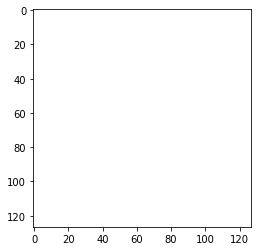

In [ ]:
from matplotlib import rc
import matplotlib.animation as animation

rc('animation', html='jshtml')

fig = plt.figure()
ims = []
for i in range(0,230,1):
    im = plt.imshow(array_to_img(TrueColorNZ[i,:,:,:]), animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True) 

#please ignore the empty image plotted after the execution and run the next cell

In [ ]:
ani #takes around 1 minute and probably won't show all the image due to memory limitation, but still helpful

Animation size has reached 21029599 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Baseline solution


This is a naive solution based on *analog methods* (aka K-NN regression), but used here for regression instead of forecasting. 

The idea consists in taking for a test sample its nearest neighbor training CloudTop image, then using its corresponding TrueColor image as the prediction.

This baseline solution serves also to show an example of the output needed for submission

In [ ]:
from sklearn.neighbors import BallTree

In [ ]:
MM = CloudTopNZ.reshape((CloudTopNZ.shape[0],-1))
tree = BallTree(MM, leaf_size=2)

use test data

In [ ]:
X_test = np.load("My Drive/DataChallengeCI2020/X_test_CI20_phase1.npy")
dictAnalogs = {}
predictions = np.zeros(X_test.shape)
for i in range(X_test.shape[0]):
  dist, ind = tree.query(X_test[i,...].reshape((1,127*127*3)), k=3)
  dictAnalogs[i] = ind
  print(i, dist, ind)
  predictions[i,:] = (TrueColorNZ[ind[0],:,:,:]).mean(0)

0 [[8548.03614873 8563.97098314 8621.29619025]] [[3911 3897 3585]]
1 [[7943.09593295 8062.87299912 8123.4202772 ]] [[3584 3609 3843]]
2 [[7020.11274838 7060.7395505  7187.78102059]] [[3608 3855 3842]]
3 [[6774.62906734 6829.7784005  6856.92175834]] [[3854 2933 3607]]
4 [[6662.16233666 6945.32130286 6996.52385117]] [[4358  692  693]]
5 [[6948.08585151 7159.90349097 7202.8619312 ]] [[4358  693 2131]]
6 [[6998.36173686 7175.19045043 7363.82848795]] [[4358  693 2131]]
7 [[7289.05981592 7461.57999354 7556.17059098]] [[4358  694  692]]
8 [[6829.76295343 6870.68038843 7080.43324946]] [[972 973  40]]
9 [[6639.99209337 6644.99902182 6714.93730425]] [[ 41 747 550]]
10 [[6009.49332307 6039.34317621 6069.5855707 ]] [[ 187 4304   42]]
11 [[5474.21208942 5535.33142639 5759.45848149]] [[4303  188   43]]
12 [[5746.79641192 5971.19728363 5990.28463431]] [[553 992 968]]
13 [[10362.24237315 10546.00028447 10599.36375449]] [[4313 4319 1940]]
14 [[8813.53884657 8873.02868247 8972.99459489]] [[4319 4312 393

look at the analogs of one random test image

Text(0.5, 1.0, 'Analog 3')

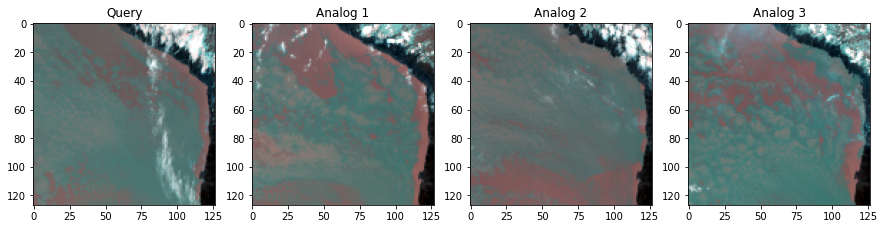

In [ ]:
randindex2=np.random.randint(0,X_test.shape[0]) 

plt.figure(figsize=(15,15))
plt.subplot(2,4,1)
plt.imshow(array_to_img(X_test[randindex2,:,:,:]))
plt.title("Query")

plt.subplot(2,4,2)
plt.imshow(array_to_img(CloudTopNZ[dictAnalogs[randindex2][0,0],:,:,:]))
plt.title("Analog 1")

plt.subplot(2,4,3)
plt.imshow(array_to_img(CloudTopNZ[dictAnalogs[randindex2][0,1],:,:,:]))
plt.title("Analog 2")

plt.subplot(2,4,4)
plt.imshow(array_to_img(CloudTopNZ[dictAnalogs[randindex2][0,2],:,:,:]))
plt.title("Analog 3")

## Submitting to the online challenge



This script will generate a file called Y_test_CI20_phase1.predict, go to the folder you created in your Google Drive, download the Y_test_CI20.predict file, zip it then submit it in the codalab platform

In [ ]:
#We save our prediction, and will then have to submit the zipped numpy array on Codalab
np.save('My Drive/DataChallengeCI2020/Y_test_CI20_phase1.npy', predictions)
!mv 'My Drive/DataChallengeCI2020/Y_test_CI20_phase1.npy' 'My Drive/DataChallengeCI2020/Y_test_CI20_phase1.predict'

## References

1. Schmit, Timothy J., Jun Li, Jinlong Li, Wayne F. Feltz, James J. Gurka, Mitchell D. Goldberg, and Kevin J. Schrab. 2008. ‘The GOES-R Advanced Baseline Imager and the Continuation of Current Sounder Products’. Journal of Applied Meteorology and Climatology 47 (10): 2696–2711. https://doi.org/10.1175/2008JAMC1858.1.

2. Schmit, Timothy J., Paul Griffith, Mathew M. Gunshor, Jaime M. Daniels, Steven J. Goodman, and William J. Lebair. 2016. ‘A Closer Look at the ABI on the GOES-R Series’. Bulletin of the American Meteorological Society 98 (4): 681–98. https://doi.org/10.1175/BAMS-D-15-00230.1.

3. Goodman, Steven J., James Gurka, Mark DeMaria, Timothy J. Schmit, Anthony Mostek, Gary Jedlovec, Chris Siewert, et al. 2012. ‘The GOES-R Proving Ground: Accelerating User Readiness for the Next-Generation Geostationary Environmental Satellite System’. Bulletin of the American Meteorological Society 93 (7): 1029–40. https://doi.org/10.1175/BAMS-D-11-00175.1.

4. EUMETSAT User Service Division, cited 2020: MSG Interpretation Guide [Available online at https://www.eumetsat.int/website/home/Data/Training/TrainingLibrary/DAT_2044069.html]

5. Heidinger, Andrew K., Michael J. Pavolonis, Corey Calvert, Jay Hoffman, Sharon Nebuda, William Straka, Andi Walther, and Steven Wanzong. 2020. ‘Chapter 6 - ABI Cloud Products from the GOES-R Series’. In The GOES-R Series, edited by Steven J. Goodman, Timothy J. Schmit, Jaime Daniels, and Robert J. Redmon, 43–62. Elsevier. https://doi.org/10.1016/B978-0-12-814327-8.00006-8.

## Acknowledgments

The Python Codalab bundle was inspired from the blog by Nicolas Cazard (CERFACS) http://cerfacs.fr/helios/research_blog/codalab/

## Contact

Don't hesitate to contact us at using CI2020 hackathon Slack channel